In [1]:
import pandas as pd 
from sklearn.decomposition import KernelPCA 
import seaborn as sns 
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.colors import ListedColormap
import numpy as np
import plotly.express as px
import nbformat

In [2]:
from sklearn import decomposition

In [3]:
data_c = pd.read_table("data/sequence_ogt_topt_features2_JF_19Jun22.tab")
data = pd.read_table("data/sequence_ogt_topt_features2_JF_19Jun22.tab")

In [4]:
data["seq_TEMP"]

0       85
1       26
2       80
3       74
4       30
        ..
2912    25
2913    28
2914    54
2915    54
2916    35
Name: seq_TEMP, Length: 2917, dtype: int64

In [5]:
Reduction_data = data.drop(["seq_id","seq_OGT","seq_TEMP","length"], axis = 1)
Data_Full = Reduction_data.iloc[:,0:9526]
Data_Full = Data_Full.drop(Data_Full.iloc[:,574:1126],axis = 1)

In [6]:
scaler = StandardScaler()
  # transform data
Data_Full_s = scaler.fit_transform(Data_Full)
Data_Full_s = pd.DataFrame(Data_Full, columns= Data_Full.columns)
Data_Full_s

,A,C,D,E,F,G,H,I,K,L,...,YYM,YYN,YYP,YYQ,YYR,YYS,YYT,YYV,YYW,YYY
0,0.057292,0.005208,0.067708,0.093750,0.015625,0.072917,0.010417,0.078125,0.093750,0.088542,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0
1,0.128743,0.023952,0.065868,0.059880,0.053892,0.068862,0.032934,0.041916,0.017964,0.083832,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0
2,0.046154,0.003846,0.080769,0.046154,0.038462,0.076923,0.011538,0.134615,0.107692,0.084615,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0
3,0.044910,0.000000,0.020958,0.029940,0.047904,0.059880,0.008982,0.092814,0.026946,0.059880,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0
4,0.048000,0.016000,0.044000,0.108000,0.044000,0.076000,0.032000,0.092000,0.056000,0.108000,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2912,0.104418,0.016064,0.048193,0.024096,0.038153,0.130522,0.016064,0.040161,0.028112,0.054217,...,0.0,0.0,0.0,0.000000,0.000000,0.002016,0.0,0.0,0.0,0.0
2913,0.034268,0.009346,0.080997,0.077882,0.052960,0.034268,0.021807,0.087227,0.090343,0.105919,...,0.0,0.0,0.0,0.003135,0.000000,0.000000,0.0,0.0,0.0,0.0
2914,0.107256,0.006309,0.066246,0.059937,0.044164,0.088328,0.025237,0.088328,0.044164,0.072555,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0
2915,0.065630,0.012090,0.077720,0.065630,0.069085,0.051813,0.036269,0.062176,0.065630,0.077720,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0


In [7]:
pca = decomposition.PCA(n_components=2000)
pca_data = pca.fit_transform(Data_Full_s)
pca_df = pd.DataFrame(data = pca_data)
pca_df

,0,1,2,3,4,5,6,7,8,9,...,1990,1991,1992,1993,1994,1995,1996,1997,1998,1999
0,-12.931603,-9.630172,23.625360,-9.668150,-4.281196,1.774678,1.384551,0.644169,-0.742579,0.368929,...,0.000097,-0.000265,0.000220,-0.000094,-0.000077,-0.000095,-0.000511,0.000325,-0.000045,0.000499
1,5.418604,13.581542,-13.090622,1.041021,-6.470339,2.936077,2.908277,0.254284,-1.081149,-1.376651,...,0.000417,-0.000380,0.000472,0.001250,-0.000249,-0.000631,0.000187,-0.000303,0.000301,-0.000125
2,-20.896063,5.156436,11.085117,1.568976,9.601061,-1.556279,-1.167247,2.132141,-3.536614,0.090803,...,0.000674,0.000663,-0.000279,0.000031,-0.000235,-0.000396,-0.000517,0.000625,0.001122,0.000196
3,-10.184588,39.424206,-17.991970,-7.567674,12.560244,2.784130,-0.270176,-2.698208,2.575119,-0.191818,...,-0.001267,-0.000310,0.000406,0.000399,-0.000361,0.001094,-0.000707,-0.000025,-0.000046,-0.000048
4,-13.387895,9.154045,-2.909324,-0.488367,3.217613,-3.770083,0.203564,-2.222044,-1.731289,4.195091,...,-0.000278,0.000024,-0.000336,0.000133,0.000208,-0.000054,0.000328,-0.000311,0.000151,0.000042
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2912,43.886425,-19.187507,-11.047522,-3.887281,6.127032,-0.593430,-3.128659,2.914928,2.513227,1.151481,...,-0.000434,-0.000047,-0.000418,0.000577,-0.000333,-0.000438,0.001280,0.000271,-0.001148,-0.000215
2913,-50.582446,-6.630135,0.999601,-1.993791,4.140385,1.174024,0.334132,-2.242970,-1.201751,1.592099,...,-0.000172,0.000103,0.000257,-0.000022,0.000304,-0.000487,-0.000086,-0.000021,0.000705,0.000425
2914,8.470458,17.679224,5.528676,1.855472,0.101870,3.176791,-2.708097,2.697749,-1.811388,-0.275915,...,-0.000034,-0.000014,-0.000564,0.000367,0.000160,-0.000273,-0.000965,0.000219,0.000310,-0.000079
2915,-40.341383,18.099773,-6.885286,-7.316597,-3.162287,-2.315607,-0.343300,-2.012795,-0.497108,-1.706210,...,-0.000117,-0.000607,-0.001003,0.001300,0.000079,-0.000010,-0.000561,0.000463,0.000257,0.001057


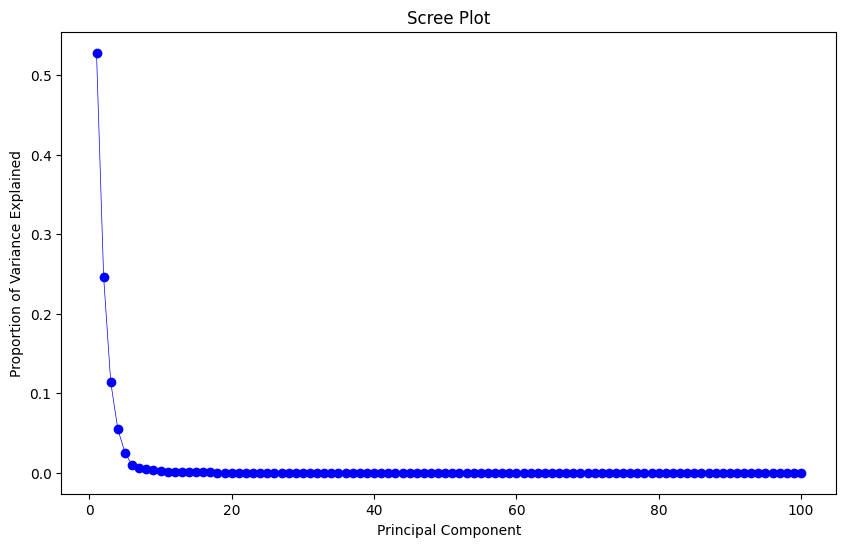

In [8]:
import numpy as np
import matplotlib
import matplotlib.pyplot as plt

PC_values = np.arange(100) + 1
plt.figure(figsize=(10,6))
plt.plot(PC_values, pca.explained_variance_ratio_[0:100], 'bo-', linewidth=0.5)
plt.title('Scree Plot')
plt.xlabel('Principal Component')
plt.ylabel('Proportion of Variance Explained')
plt.show()

In [9]:
pca.explained_variance_ratio_

array([5.28168274e-01, 2.46629428e-01, 1.13835858e-01, ...,
       2.79702242e-10, 2.78459194e-10, 2.77763274e-10])

In [10]:
pca.explained_variance_ratio_ *100

array([5.28168274e+01, 2.46629428e+01, 1.13835858e+01, ...,
       2.79702242e-08, 2.78459194e-08, 2.77763274e-08])

In [11]:
labels = {
    str(i): f"PC {i+1} ({var:.1f}%)"
    for i, var in enumerate(pca.explained_variance_ratio_ * 100)
}

fig = px.scatter_matrix(
    pca_data,
    labels=labels,
    dimensions=range(4),
    color=data["seq_TEMP"]
)
fig.update_traces(diagonal_visible=False)

fig.update_layout(
                  dragmode='select',
                  width=1500,
                  height=800,
                  hovermode='closest')
fig.show()

d:\anaconda\envs\Master_thesis\lib\site-packages\plotly\express\_core.py:279: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  dims = [


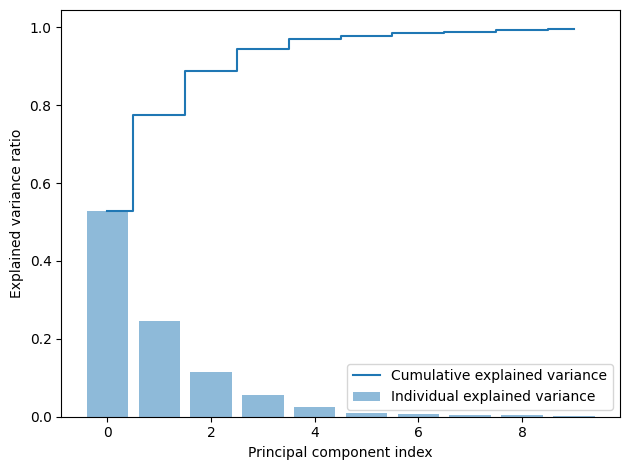

In [12]:
exp_var_pca = pca.explained_variance_ratio_
#
# Cumulative sum of eigenvalues; This will be used to create step plot
# for visualizing the variance explained by each principal component.
#
cum_sum_eigenvalues = np.cumsum(exp_var_pca)
#
# Create the visualization plot
#
plt.bar(range(0,len(exp_var_pca[0:10])), exp_var_pca[0:10], alpha=0.5, align='center', label='Individual explained variance')
plt.step(range(0,len(cum_sum_eigenvalues[0:10])), cum_sum_eigenvalues[0:10], where='mid',label='Cumulative explained variance')
plt.ylabel('Explained variance ratio')
plt.xlabel('Principal component index')
plt.legend(loc='best')
plt.tight_layout()
plt.show()

In [13]:
exp_var_pca[0:10]

array([0.52816827, 0.24662943, 0.11383586, 0.05459198, 0.02527586,
       0.00945599, 0.00604192, 0.00450962, 0.00361443, 0.00232119])

In [14]:
pca.explained_variance_ratio_

array([5.28168274e-01, 2.46629428e-01, 1.13835858e-01, ...,
       2.79702242e-10, 2.78459194e-10, 2.77763274e-10])

In [15]:
loadings = pca.components_
num_pc = pca.n_features_
pc_list = ["PC"+str(i) for i in list(range(1, num_pc+1))]
loadings_df = pd.DataFrame.from_dict(dict(zip(pc_list, loadings)))
loadings_df['variable'] = Data_Full_s.columns.values
loadings_df = loadings_df.set_index('variable')
loadings_df

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,...,PC1991,PC1992,PC1993,PC1994,PC1995,PC1996,PC1997,PC1998,PC1999,PC2000
variable,,,,,,,,,,,,,,,,,,,,,
A,9.712252e-04,-2.095536e-05,-1.015461e-04,7.379412e-04,-1.544570e-03,0.001624,-0.000391,-2.029485e-03,-0.003266,-6.820562e-03,...,-1.158707e-06,2.305503e-07,2.072859e-06,8.124902e-07,1.586907e-06,1.127376e-06,4.967817e-07,1.142387e-06,2.153998e-07,-2.034846e-06
C,3.325155e-05,1.203763e-04,-8.907624e-05,-5.731183e-04,-2.366642e-04,-0.000024,0.001712,9.239050e-04,0.000735,1.294708e-03,...,-3.714731e-07,1.775997e-07,3.664209e-07,1.359161e-07,2.199316e-07,-1.382107e-07,4.230504e-07,2.910088e-07,2.838789e-09,-4.001857e-07
D,-1.042470e-04,-1.741123e-04,-9.953400e-05,-7.328080e-04,-1.330714e-03,0.000341,-0.002228,-1.409241e-03,-0.002390,-9.020965e-04,...,-2.525970e-07,-2.817639e-07,-2.199280e-08,-6.722039e-07,-1.100265e-06,4.116198e-07,2.058117e-07,-3.984231e-08,-2.739735e-07,5.450391e-07
E,-4.755674e-04,-2.541381e-04,1.073717e-03,5.679979e-04,-1.423274e-03,-0.000277,0.000325,-1.419056e-05,-0.002805,4.673587e-03,...,4.072013e-07,8.896749e-07,-1.919319e-07,3.393088e-07,4.884274e-07,-6.166732e-07,1.446177e-07,4.271910e-07,4.418413e-07,1.737521e-07
F,-2.640202e-04,3.352429e-04,-1.557789e-04,-1.597755e-04,1.934152e-04,-0.000494,-0.000279,-2.756385e-04,0.002148,-7.826192e-04,...,-1.136249e-06,1.974526e-08,1.308605e-06,-6.282690e-07,-2.293297e-08,1.762301e-06,-3.604961e-07,2.168840e-06,1.100000e-06,1.112904e-06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
YYS,2.760992e-07,-1.589166e-06,-4.249780e-06,-4.191741e-06,8.843031e-06,-0.000009,-0.000037,1.845008e-05,0.000045,1.598061e-05,...,1.159215e-02,2.829907e-02,-2.128639e-04,1.007736e-02,-1.412197e-03,-1.476444e-02,-4.019553e-03,-1.729488e-02,-1.732136e-02,-2.984746e-03
YYT,-9.937896e-07,1.236776e-06,-4.717512e-06,-3.186624e-06,4.114071e-06,-0.000009,-0.000020,9.746500e-08,0.000023,-1.656557e-05,...,-1.357601e-02,1.210351e-02,-9.520330e-03,-5.100905e-03,1.066573e-02,-1.084427e-02,8.511142e-03,2.368571e-02,1.909454e-02,-1.313457e-02
YYV,-5.471769e-07,-1.255475e-06,-6.943026e-07,7.483279e-07,8.192994e-06,-0.000009,-0.000020,6.945580e-06,0.000018,-9.666977e-07,...,-9.539255e-03,2.058496e-02,-6.171812e-03,-1.600292e-02,-1.344126e-02,-7.675396e-03,1.101866e-02,5.710949e-03,1.996091e-03,7.295040e-03


In [16]:
loadings_df = loadings_df.iloc[:,0:1000]

In [17]:
loadings_df


,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,...,PC991,PC992,PC993,PC994,PC995,PC996,PC997,PC998,PC999,PC1000
variable,,,,,,,,,,,,,,,,,,,,,
A,9.712252e-04,-2.095536e-05,-1.015461e-04,7.379412e-04,-1.544570e-03,0.001624,-0.000391,-2.029485e-03,-0.003266,-6.820562e-03,...,-1.315069e-07,-2.449177e-07,9.526092e-07,-8.114046e-07,3.041014e-08,-3.091452e-06,6.836752e-07,3.424090e-06,-1.605987e-06,-2.445893e-06
C,3.325155e-05,1.203763e-04,-8.907624e-05,-5.731183e-04,-2.366642e-04,-0.000024,0.001712,9.239050e-04,0.000735,1.294708e-03,...,1.319662e-07,-2.461455e-08,1.123079e-07,-5.738472e-07,-6.320638e-07,-2.702666e-07,8.825785e-08,1.631555e-07,-1.790496e-07,-4.118671e-07
D,-1.042470e-04,-1.741123e-04,-9.953400e-05,-7.328080e-04,-1.330714e-03,0.000341,-0.002228,-1.409241e-03,-0.002390,-9.020965e-04,...,3.180090e-07,-4.396130e-07,-1.173701e-06,1.322419e-07,4.426982e-07,7.783939e-07,3.304737e-07,-3.201090e-07,3.130547e-07,7.556470e-07
E,-4.755674e-04,-2.541381e-04,1.073717e-03,5.679979e-04,-1.423274e-03,-0.000277,0.000325,-1.419056e-05,-0.002805,4.673587e-03,...,5.681806e-07,-3.310890e-08,8.815774e-07,-2.283169e-07,-9.721572e-07,-4.006410e-07,-2.634300e-07,-1.143406e-06,3.499568e-09,-5.067053e-07
F,-2.640202e-04,3.352429e-04,-1.557789e-04,-1.597755e-04,1.934152e-04,-0.000494,-0.000279,-2.756385e-04,0.002148,-7.826192e-04,...,6.264170e-07,-1.876911e-06,-1.562988e-06,4.053389e-07,1.855736e-06,-1.353106e-06,2.122462e-08,2.185074e-06,-1.367417e-06,-4.299697e-07
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
YYS,2.760992e-07,-1.589166e-06,-4.249780e-06,-4.191741e-06,8.843031e-06,-0.000009,-0.000037,1.845008e-05,0.000045,1.598061e-05,...,1.478204e-02,1.070947e-03,6.621781e-03,-3.425702e-03,1.252254e-02,-4.561686e-04,-2.398932e-03,1.183379e-02,-6.558637e-03,8.467206e-03
YYT,-9.937896e-07,1.236776e-06,-4.717512e-06,-3.186624e-06,4.114071e-06,-0.000009,-0.000020,9.746500e-08,0.000023,-1.656557e-05,...,-3.722431e-03,-7.373599e-04,-3.458076e-03,-8.115365e-04,4.386155e-03,8.898167e-05,5.996997e-03,-1.897626e-02,2.718307e-03,-6.636566e-03
YYV,-5.471769e-07,-1.255475e-06,-6.943026e-07,7.483279e-07,8.192994e-06,-0.000009,-0.000020,6.945580e-06,0.000018,-9.666977e-07,...,-4.752122e-03,1.279633e-03,2.700415e-03,-2.993077e-03,5.392412e-03,1.182555e-02,-2.443977e-03,1.233340e-02,1.284874e-02,1.192300e-02


In [18]:
loadings_df["PC1"]

variable
A      9.712252e-04
C      3.325155e-05
D     -1.042470e-04
E     -4.755674e-04
F     -2.640202e-04
           ...     
YYS    2.760992e-07
YYT   -9.937896e-07
YYV   -5.471769e-07
YYW   -3.192951e-07
YYY   -1.074244e-06
Name: PC1, Length: 8974, dtype: float64

In [19]:
df_pc1 = pd.DataFrame()
df_pc1["variable"] = loadings_df.index
df_pc1["PC1"] = loadings_df["PC1"].values
df_pc1 = df_pc1.sort_values(['PC1'], ascending=[0])
df_pc1

,variable,PC1
156,JUNJ780101,0.561587
466,NADH010102,0.201498
30,BIOV880102,0.150415
467,NADH010103,0.124783
465,NADH010101,0.119555
...,...,...
524,PONJ960101,-0.191476
51,CHOC750101,-0.192338
137,HUTJ700103,-0.202873
52,CHOC760101,-0.207415


In [20]:
pc_1_l = df_pc1.iloc[0:10,:]
pc_1_l2 = df_pc1.iloc[8964:8974,:]
pc_1_l = pc_1_l.append(pc_1_l2)
pc_1_l

C:\Users\venka\AppData\Local\Temp\ipykernel_26308\1608559487.py:3: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



,variable,PC1
156,JUNJ780101,0.561587
466,NADH010102,0.201498
30,BIOV880102,0.150415
467,NADH010103,0.124783
465,NADH010101,0.119555
175,LEVM760104,0.106850
468,NADH010104,0.083656
164,KHAG800101,0.082235
147,JANJ780102,0.052876
29,BIOV880101,0.045984


In [21]:
pc_1_l.index = pc_1_l["variable"]
pc_1_l = pc_1_l.drop(columns=['variable'], axis = 1)

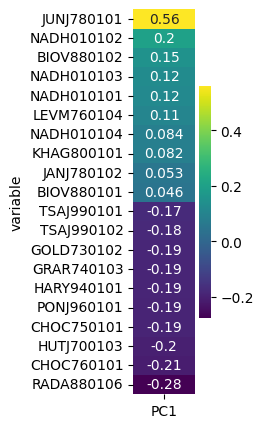

In [22]:
fig, ax = plt.subplots(figsize=(1,5)) 
hm = sns.heatmap(data=pc_1_l,annot=True, cmap = "viridis", ax = ax)

In [23]:
df_pc2 = pd.DataFrame()
df_pc2["variable"] = loadings_df.index
df_pc2["PC2"] = loadings_df["PC2"].values
df_pc2 = df_pc2.sort_values(['PC2'], ascending=[0])


In [24]:
pc_2_l = df_pc2.iloc[0:10,:]
pc_2_l2 = df_pc2.iloc[8964:8974,:]
pc_2_l = pc_2_l.append(pc_2_l2)

pc_2_l.index = pc_2_l["variable"]
pc_2_l = pc_2_l.drop(columns=['variable'], axis = 1)

hm = sns.heatmap(data=pc_2_l,annot=True, cmap = "viridis", ax = ax)

C:\Users\venka\AppData\Local\Temp\ipykernel_26308\1679386907.py:3: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



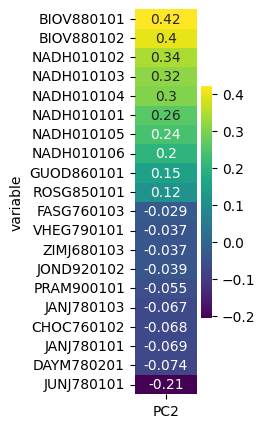

In [25]:
fig, ax = plt.subplots(figsize=(1,5)) 
hm = sns.heatmap(data=pc_2_l,annot=True, cmap = "viridis", ax = ax)

In [26]:
df_pc3 = pd.DataFrame()
df_pc3["variable"] = loadings_df.index
df_pc3["PC3"] = loadings_df["PC3"].values
df_pc3 = df_pc3.sort_values(['PC3'], ascending=[0])
df_pc3

,variable,PC3
156,JUNJ780101,0.631522
471,NADH010107,0.434053
465,NADH010101,0.235671
338,RADA880106,0.215894
469,NADH010105,0.212024
...,...,...
332,RACS820114,-0.044166
383,SUEM840102,-0.047441
466,NADH010102,-0.051196
164,KHAG800101,-0.142861


C:\Users\venka\AppData\Local\Temp\ipykernel_26308\635727712.py:3: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



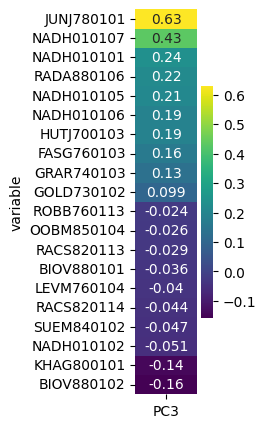

In [27]:
pc_3_l = df_pc3.iloc[0:10,:]
pc_3_l2 = df_pc3.iloc[8964:8974,:]
pc_3_l = pc_3_l.append(pc_3_l2)

pc_3_l.index = pc_3_l["variable"]
pc_3_l = pc_3_l.drop(columns=['variable'], axis = 1)

fig, ax = plt.subplots(figsize=(1,5)) 
hm = sns.heatmap(data=pc_3_l,annot=True, cmap = "viridis", ax = ax)

In [28]:
df_pc4 = pd.DataFrame()
df_pc4["variable"] = loadings_df.index
df_pc4["PC4"] = loadings_df["PC4"].values
df_pc4 = df_pc4.sort_values(['PC4'], ascending=[0])
df_pc4

,variable,PC4
156,JUNJ780101,0.375863
164,KHAG800101,0.236147
137,HUTJ700103,0.205960
30,BIOV880102,0.183912
92,FASG760102,0.167229
...,...,...
84,DAYM780201,-0.114501
469,NADH010105,-0.154866
465,NADH010101,-0.155150
470,NADH010106,-0.226397


C:\Users\venka\AppData\Local\Temp\ipykernel_26308\2950150066.py:3: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



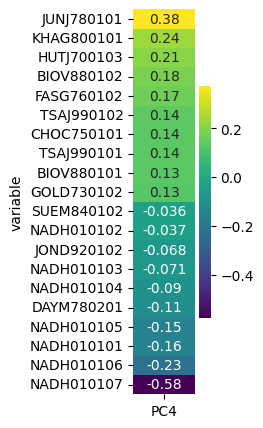

In [29]:
pc_4_l = df_pc4.iloc[0:10,:]
pc_4_l2 = df_pc4.iloc[8964:8974,:]
pc_4_l = pc_4_l.append(pc_4_l2)

pc_4_l.index = pc_4_l["variable"]
pc_4_l = pc_4_l.drop(columns=['variable'], axis = 1)

fig, ax = plt.subplots(figsize=(1,5)) 
hm = sns.heatmap(data=pc_4_l,annot=True, cmap = "viridis", ax = ax)

In [30]:
frame = []

In [31]:
def temp_range_to_no(value):
    if value <= 20:
        return 0
    elif value <= 40 and value > 20:
        return 1
    elif value <= 60 and value > 40:
        return 2
    elif value <= 80 and value > 60:
        return 3
    else:
        return 4

In [32]:
input_d = pca_df.iloc[:,0:1000]


In [33]:
input_d["Topt"] = data["seq_TEMP"]

C:\Users\venka\AppData\Local\Temp\ipykernel_26308\1465419773.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [34]:
input_d

,0,1,2,3,4,5,6,7,8,9,...,991,992,993,994,995,996,997,998,999,Topt
0,-12.931603,-9.630172,23.625360,-9.668150,-4.281196,1.774678,1.384551,0.644169,-0.742579,0.368929,...,-0.001760,0.000841,0.000190,0.002254,-0.000971,0.001378,0.000693,0.000664,0.000004,85
1,5.418604,13.581542,-13.090622,1.041021,-6.470339,2.936077,2.908277,0.254284,-1.081149,-1.376651,...,0.000345,0.001215,-0.001573,-0.001889,-0.001165,0.001050,-0.000479,0.000156,0.001097,26
2,-20.896063,5.156436,11.085117,1.568976,9.601061,-1.556279,-1.167247,2.132141,-3.536614,0.090803,...,0.001913,0.000102,-0.000865,0.000383,0.000248,-0.000776,-0.000445,-0.001706,0.000762,80
3,-10.184588,39.424206,-17.991970,-7.567674,12.560244,2.784130,-0.270176,-2.698208,2.575119,-0.191818,...,0.001208,-0.000447,0.000276,-0.000961,0.000218,-0.000453,0.001137,-0.000515,0.000172,74
4,-13.387895,9.154045,-2.909324,-0.488367,3.217613,-3.770083,0.203564,-2.222044,-1.731289,4.195091,...,-0.000077,0.000276,-0.000158,0.000218,0.000507,-0.000281,-0.000504,-0.000359,-0.000442,30
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2912,43.886425,-19.187507,-11.047522,-3.887281,6.127032,-0.593430,-3.128659,2.914928,2.513227,1.151481,...,0.001330,0.000308,0.000398,0.000634,0.000353,-0.000618,-0.000730,-0.000618,-0.000084,25
2913,-50.582446,-6.630135,0.999601,-1.993791,4.140385,1.174024,0.334132,-2.242970,-1.201751,1.592099,...,0.002088,-0.000361,0.001172,0.000252,-0.002833,0.001356,0.001377,-0.000044,0.000174,28
2914,8.470458,17.679224,5.528676,1.855472,0.101870,3.176791,-2.708097,2.697749,-1.811388,-0.275915,...,-0.000053,-0.000311,-0.000615,-0.002560,0.001324,0.001720,-0.001056,-0.001440,0.000677,54
2915,-40.341383,18.099773,-6.885286,-7.316597,-3.162287,-2.315607,-0.343300,-2.012795,-0.497108,-1.706210,...,-0.000026,0.000823,0.001517,-0.000072,0.000704,0.001548,0.000257,0.000897,-0.001974,54


In [35]:
import pandas as pd 
from sklearn.decomposition import KernelPCA 
import seaborn as sns 
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.colors import ListedColormap
import numpy as np
import plotly.express as px
import nbformat
from imblearn.over_sampling import SMOTE
from collections import Counter
from matplotlib import pyplot
from sklearn.preprocessing import LabelEncoder
from sklearn import ensemble
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.model_selection import train_test_split
import shap
from reg_resampler import resampler
import plotly.graph_objects as go
from sklearn.metrics import roc_auc_score
import xgboost as xgb
from sklearn import preprocessing
from sklearn.preprocessing import MinMaxScaler
import missingno as msno
from imblearn.combine import SMOTEENN

In [36]:
model2 = xgb.XGBRegressor(
                         num_parallel_tree = 1,
                         max_depth = 3,
                         n_estimators=2000,
                         learning_rate = 0.05,
                         verbosity = 2,
                         booster = 'gbtree',
                         n_jobs = -1,
                         sampling_method ='uniform',
                         subsample = 0.5,
                         colsample_bytree = 1.0,
                         objective ='reg:squarederror',
                         gamma = 10,
                         reg_alpha = 5,
                         reg_lambda =5,
                         eval_metric = ["rmse"]
                        )

In [37]:
from verstack.stratified_continuous_split import scsplit
train, test = scsplit(input_d, stratify = input_d["Topt"],test_size = 0.2,
                                             train_size = 0.8, random_state = 1)

In [38]:
# implement SMOTER
# see paper: https://core.ac.uk/download/pdf/29202178.pdf
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics.pairwise import cosine_similarity

def sigmoid(x):
    return 1 / (1 + np.exp(-x))

def relevance(x):
    x = np.array(x)
    return sigmoid(x - 50)

def get_synth_cases(D, target, o=200, k=3, categorical_col = []):
    '''
    Function to generate the new cases.
    INPUT:
        D - pd.DataFrame with the initial data
        target - string name of the target column in the dataset
        o - oversampling rate
        k - number of nearest neighbors to use for the generation
        categorical_col - list of categorical column names
    OUTPUT:
        new_cases - pd.DataFrame containing new generated cases
    '''
    new_cases = pd.DataFrame(columns = D.columns) # initialize the list of new cases 
    ng = o // 100 # the number of new cases to generate
    for index, case in D.iterrows():
        # find k nearest neighbors of the case
        knn = KNeighborsRegressor(n_neighbors = k+1) # k+1 because the case is the nearest neighbor to itself
        knn.fit(D.drop(columns = [target]).values, D[[target]])
        neighbors = knn.kneighbors(case.drop(labels = [target]).values.reshape(1, -1), return_distance=False).reshape(-1)
        neighbors = np.delete(neighbors, np.where(neighbors == index))
        for i in range(0, ng):
            # randomly choose one of the neighbors
            x = D.iloc[neighbors[np.random.randint(k)]]
            attr = {}          
            for a in D.columns:
                # skip target column
                if a == target:
                    continue;
                if a in categorical_col:
                    # if categorical then choose randomly one of values
                    if np.random.randint(2) == 0:
                        attr[a] = case[a]
                    else:
                        attr[a] = x[a]
                else:
                    # if continious column
                    diff = case[a] - x[a]
                    attr[a] = case[a] + np.random.randint(2) * diff
            # decide the target column
            new = np.array(list(attr.values()))
            d1 = cosine_similarity(new.reshape(1, -1), case.drop(labels = [target]).values.reshape(1, -1))[0][0]
            d2 = cosine_similarity(new.reshape(1, -1), x.drop(labels = [target]).values.reshape(1, -1))[0][0]
            attr[target] = (d2 * case[target] + d1 * x[target]) / (d1 + d2)
            
            # append the result
            new_cases = new_cases.append(attr,ignore_index = True)
                    
    return new_cases

def SmoteR(D, target, th = 0.999, o = 200, u = 100, k = 3, categorical_col = []):
    '''
    The implementation of SmoteR algorithm:
    https://core.ac.uk/download/pdf/29202178.pdf
    INPUT:
        D - pd.DataFrame - the initial dataset
        target - the name of the target column in the dataset
        th - relevance threshold
        o - oversampling rate
        u - undersampling rate
        k - the number of nearest neighbors
    OUTPUT:
        new_D - the resulting new dataset
    '''
    # median of the target variable
    y_bar = D[target].median()
    
    # find rare cases where target less than median
    rareL = D[(relevance(D[target]) > th) & (D[target] > y_bar)]  
    # generate rare cases for rareL
    new_casesL = get_synth_cases(rareL, target, o, k , categorical_col)
    
    # find rare cases where target greater than median
    rareH = D[(relevance(D[target]) > th) & (D[target] < y_bar)]
    # generate rare cases for rareH
    new_casesH = get_synth_cases(rareH, target, o, k , categorical_col)
    
    new_cases = pd.concat([new_casesL, new_casesH], axis=0)
    
    # undersample norm cases
    norm_cases = D[relevance(D[target]) <= th]
    # get the number of norm cases
    nr_norm = int(len(norm_cases) * u / 100)
    
    norm_cases = norm_cases.sample(min(len(D[relevance(D[target]) <= th]), nr_norm))
    
    # get the resulting dataset
    new_D = pd.concat([new_cases, norm_cases], axis=0)
    
    return new_D

In [39]:
train

,0,1,2,3,4,5,6,7,8,9,...,991,992,993,994,995,996,997,998,999,Topt
2494,1.929190,8.207840,0.106958,19.540812,-10.318074,-7.747422,-1.573517,-1.761679,1.534430,2.700642,...,-0.001230,0.000715,-0.000518,0.000653,0.000719,-0.000297,-0.000608,-0.000195,-0.000369,71
854,65.529786,-2.933886,8.671085,-1.428834,3.431611,2.040933,-2.187967,0.249756,2.503071,-2.196005,...,0.000090,-0.000806,-0.001303,-0.000979,0.000456,0.000934,0.001421,0.000543,0.000291,28
592,-24.710842,4.238855,-7.459398,-15.346256,-9.575595,-2.108538,0.348317,-1.526069,1.634454,-0.302586,...,-0.001215,-0.001902,-0.000527,-0.000230,0.001843,0.000333,-0.001036,-0.000461,-0.003039,31
2180,17.254907,-3.498393,-3.949608,7.354399,-0.711922,-1.519565,0.163158,-1.935134,-1.556093,-0.212815,...,0.000432,-0.000561,-0.000622,-0.000257,-0.000685,0.000341,0.001009,0.000148,-0.000222,28
2318,-1.985478,3.717643,-10.386006,11.796092,-7.428529,2.921195,0.303058,0.125082,-0.617372,-0.551092,...,0.002401,0.000132,-0.000437,-0.001793,-0.000223,0.002087,-0.003155,-0.001725,0.001104,27
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1586,-31.881966,10.368996,-3.994975,-0.918128,6.530053,2.272559,-5.061575,0.797893,-1.079409,-1.021981,...,0.000907,0.000984,-0.000783,0.001170,-0.001234,0.000651,0.000002,-0.000942,0.000665,55
2095,-33.068031,4.887212,-4.027277,-0.061813,1.062538,-0.876028,-4.820515,0.645010,-1.542626,-1.203720,...,0.001952,0.000306,-0.002775,0.001474,0.003172,0.000280,-0.002462,0.000433,-0.000105,37
1460,1.099174,-43.262071,8.966198,-7.184046,-0.601568,6.042097,2.840783,-6.285975,4.830795,1.311071,...,0.000523,-0.000503,-0.000522,-0.000107,0.000454,-0.000405,-0.000892,-0.000674,0.000092,37
2584,-12.064773,-4.931734,-1.701332,5.024627,4.717670,-1.456703,-3.776232,-0.076983,-2.547369,-1.152949,...,-0.000926,0.000166,-0.000093,0.000175,0.000988,-0.000444,-0.000561,0.000658,0.000243,33


In [40]:
train['Topt'] = train['Topt'].apply(np.ceil)
train

,0,1,2,3,4,5,6,7,8,9,...,991,992,993,994,995,996,997,998,999,Topt
2494,1.929190,8.207840,0.106958,19.540812,-10.318074,-7.747422,-1.573517,-1.761679,1.534430,2.700642,...,-0.001230,0.000715,-0.000518,0.000653,0.000719,-0.000297,-0.000608,-0.000195,-0.000369,71.0
854,65.529786,-2.933886,8.671085,-1.428834,3.431611,2.040933,-2.187967,0.249756,2.503071,-2.196005,...,0.000090,-0.000806,-0.001303,-0.000979,0.000456,0.000934,0.001421,0.000543,0.000291,28.0
592,-24.710842,4.238855,-7.459398,-15.346256,-9.575595,-2.108538,0.348317,-1.526069,1.634454,-0.302586,...,-0.001215,-0.001902,-0.000527,-0.000230,0.001843,0.000333,-0.001036,-0.000461,-0.003039,31.0
2180,17.254907,-3.498393,-3.949608,7.354399,-0.711922,-1.519565,0.163158,-1.935134,-1.556093,-0.212815,...,0.000432,-0.000561,-0.000622,-0.000257,-0.000685,0.000341,0.001009,0.000148,-0.000222,28.0
2318,-1.985478,3.717643,-10.386006,11.796092,-7.428529,2.921195,0.303058,0.125082,-0.617372,-0.551092,...,0.002401,0.000132,-0.000437,-0.001793,-0.000223,0.002087,-0.003155,-0.001725,0.001104,27.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1586,-31.881966,10.368996,-3.994975,-0.918128,6.530053,2.272559,-5.061575,0.797893,-1.079409,-1.021981,...,0.000907,0.000984,-0.000783,0.001170,-0.001234,0.000651,0.000002,-0.000942,0.000665,55.0
2095,-33.068031,4.887212,-4.027277,-0.061813,1.062538,-0.876028,-4.820515,0.645010,-1.542626,-1.203720,...,0.001952,0.000306,-0.002775,0.001474,0.003172,0.000280,-0.002462,0.000433,-0.000105,37.0
1460,1.099174,-43.262071,8.966198,-7.184046,-0.601568,6.042097,2.840783,-6.285975,4.830795,1.311071,...,0.000523,-0.000503,-0.000522,-0.000107,0.000454,-0.000405,-0.000892,-0.000674,0.000092,37.0
2584,-12.064773,-4.931734,-1.701332,5.024627,4.717670,-1.456703,-3.776232,-0.076983,-2.547369,-1.152949,...,-0.000926,0.000166,-0.000093,0.000175,0.000988,-0.000444,-0.000561,0.000658,0.000243,33.0


In [41]:
train["Topt"] = train["Topt"].astype('int')
train

,0,1,2,3,4,5,6,7,8,9,...,991,992,993,994,995,996,997,998,999,Topt
2494,1.929190,8.207840,0.106958,19.540812,-10.318074,-7.747422,-1.573517,-1.761679,1.534430,2.700642,...,-0.001230,0.000715,-0.000518,0.000653,0.000719,-0.000297,-0.000608,-0.000195,-0.000369,71
854,65.529786,-2.933886,8.671085,-1.428834,3.431611,2.040933,-2.187967,0.249756,2.503071,-2.196005,...,0.000090,-0.000806,-0.001303,-0.000979,0.000456,0.000934,0.001421,0.000543,0.000291,28
592,-24.710842,4.238855,-7.459398,-15.346256,-9.575595,-2.108538,0.348317,-1.526069,1.634454,-0.302586,...,-0.001215,-0.001902,-0.000527,-0.000230,0.001843,0.000333,-0.001036,-0.000461,-0.003039,31
2180,17.254907,-3.498393,-3.949608,7.354399,-0.711922,-1.519565,0.163158,-1.935134,-1.556093,-0.212815,...,0.000432,-0.000561,-0.000622,-0.000257,-0.000685,0.000341,0.001009,0.000148,-0.000222,28
2318,-1.985478,3.717643,-10.386006,11.796092,-7.428529,2.921195,0.303058,0.125082,-0.617372,-0.551092,...,0.002401,0.000132,-0.000437,-0.001793,-0.000223,0.002087,-0.003155,-0.001725,0.001104,27
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1586,-31.881966,10.368996,-3.994975,-0.918128,6.530053,2.272559,-5.061575,0.797893,-1.079409,-1.021981,...,0.000907,0.000984,-0.000783,0.001170,-0.001234,0.000651,0.000002,-0.000942,0.000665,55
2095,-33.068031,4.887212,-4.027277,-0.061813,1.062538,-0.876028,-4.820515,0.645010,-1.542626,-1.203720,...,0.001952,0.000306,-0.002775,0.001474,0.003172,0.000280,-0.002462,0.000433,-0.000105,37
1460,1.099174,-43.262071,8.966198,-7.184046,-0.601568,6.042097,2.840783,-6.285975,4.830795,1.311071,...,0.000523,-0.000503,-0.000522,-0.000107,0.000454,-0.000405,-0.000892,-0.000674,0.000092,37
2584,-12.064773,-4.931734,-1.701332,5.024627,4.717670,-1.456703,-3.776232,-0.076983,-2.547369,-1.152949,...,-0.000926,0.000166,-0.000093,0.000175,0.000988,-0.000444,-0.000561,0.000658,0.000243,33


In [42]:
train

,0,1,2,3,4,5,6,7,8,9,...,991,992,993,994,995,996,997,998,999,Topt
2494,1.929190,8.207840,0.106958,19.540812,-10.318074,-7.747422,-1.573517,-1.761679,1.534430,2.700642,...,-0.001230,0.000715,-0.000518,0.000653,0.000719,-0.000297,-0.000608,-0.000195,-0.000369,71
854,65.529786,-2.933886,8.671085,-1.428834,3.431611,2.040933,-2.187967,0.249756,2.503071,-2.196005,...,0.000090,-0.000806,-0.001303,-0.000979,0.000456,0.000934,0.001421,0.000543,0.000291,28
592,-24.710842,4.238855,-7.459398,-15.346256,-9.575595,-2.108538,0.348317,-1.526069,1.634454,-0.302586,...,-0.001215,-0.001902,-0.000527,-0.000230,0.001843,0.000333,-0.001036,-0.000461,-0.003039,31
2180,17.254907,-3.498393,-3.949608,7.354399,-0.711922,-1.519565,0.163158,-1.935134,-1.556093,-0.212815,...,0.000432,-0.000561,-0.000622,-0.000257,-0.000685,0.000341,0.001009,0.000148,-0.000222,28
2318,-1.985478,3.717643,-10.386006,11.796092,-7.428529,2.921195,0.303058,0.125082,-0.617372,-0.551092,...,0.002401,0.000132,-0.000437,-0.001793,-0.000223,0.002087,-0.003155,-0.001725,0.001104,27
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1586,-31.881966,10.368996,-3.994975,-0.918128,6.530053,2.272559,-5.061575,0.797893,-1.079409,-1.021981,...,0.000907,0.000984,-0.000783,0.001170,-0.001234,0.000651,0.000002,-0.000942,0.000665,55
2095,-33.068031,4.887212,-4.027277,-0.061813,1.062538,-0.876028,-4.820515,0.645010,-1.542626,-1.203720,...,0.001952,0.000306,-0.002775,0.001474,0.003172,0.000280,-0.002462,0.000433,-0.000105,37
1460,1.099174,-43.262071,8.966198,-7.184046,-0.601568,6.042097,2.840783,-6.285975,4.830795,1.311071,...,0.000523,-0.000503,-0.000522,-0.000107,0.000454,-0.000405,-0.000892,-0.000674,0.000092,37
2584,-12.064773,-4.931734,-1.701332,5.024627,4.717670,-1.456703,-3.776232,-0.076983,-2.547369,-1.152949,...,-0.000926,0.000166,-0.000093,0.000175,0.000988,-0.000444,-0.000561,0.000658,0.000243,33


In [43]:
test

,0,1,2,3,4,5,6,7,8,9,...,991,992,993,994,995,996,997,998,999,Topt
1465,-21.998596,2.806012,11.903586,6.518911,-1.863154,-1.544587,-1.014750,-0.755313,1.986929,1.166919,...,0.001109,0.001793,-0.000871,-0.000748,0.000261,0.000679,-0.001386,-0.000352,-0.001090,90
1091,-11.450146,-4.392470,10.343035,0.697333,-0.563600,0.078801,1.353508,4.720302,-0.346811,1.060433,...,0.000181,0.001416,0.001122,-0.000940,-0.000020,-0.000193,-0.000423,0.000282,0.001589,74
1373,-32.884614,-4.314731,3.694495,2.255916,-3.533099,-3.827040,-0.757867,0.289926,0.029262,-0.109294,...,0.000544,-0.000813,0.001027,0.000734,0.000065,-0.000179,0.001062,0.000610,-0.000460,60
1478,-20.259355,-26.718001,5.927935,9.224618,3.861501,-3.396409,-2.019388,0.213254,0.272699,2.351212,...,0.000557,-0.000037,0.002250,-0.001484,-0.000316,0.001826,-0.002536,0.000592,-0.001277,25
2361,-13.679161,28.825195,9.352508,-2.343707,3.642842,1.690765,-0.060868,0.094431,3.726920,-1.454712,...,0.001009,0.000694,-0.000550,0.000667,0.000534,0.000444,0.000755,-0.001853,-0.001156,26
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
205,15.526664,9.094106,-0.796672,7.046034,-2.009167,-3.327018,0.662406,0.838662,-2.280278,-1.188892,...,0.000015,0.002156,-0.000461,0.000530,-0.001094,-0.000523,0.000501,0.000094,-0.000661,71
1097,-24.610950,1.481002,14.597619,-3.369868,0.357921,-2.909399,0.515311,1.991641,-1.239160,1.385813,...,0.000177,-0.000218,0.000014,0.000437,0.000961,0.002680,0.002252,0.001200,-0.000384,80
2342,-13.715726,12.322291,-1.963109,-1.557318,2.470870,-3.404819,-0.214596,-1.973365,-1.627758,3.472448,...,-0.000127,0.000464,-0.000531,0.000635,0.000450,-0.000200,0.000119,-0.000805,-0.000798,30
1963,-41.704267,-0.584770,5.112554,-4.397182,-7.145253,-5.479360,2.288914,0.171882,2.107620,-0.695154,...,-0.000133,0.000029,0.000662,-0.000495,-0.000560,0.000231,-0.000128,0.001570,0.000887,80


In [44]:
X_train = train.drop(columns=["Topt"], axis = 1)
X_test  = test.drop(columns=["Topt"], axis = 1)
y_train = train["Topt"]
y_test  = test["Topt"]

In [45]:
model2.fit(X_train,y_train,eval_set=[(X_test, y_test)],early_stopping_rounds=10)

[20:35:44] INFO: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/tree/updater_prune.cc:98: tree pruning end, 14 extra nodes, 0 pruned nodes, max_depth=3
[0]	validation_0-rmse:43.08001
[20:35:44] INFO: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/tree/updater_prune.cc:98: tree pruning end, 14 extra nodes, 0 pruned nodes, max_depth=3
[1]	validation_0-rmse:41.36424
[20:35:45] INFO: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/tree/updater_prune.cc:98: tree pruning end, 14 extra nodes, 0 pruned nodes, max_depth=3
[2]	validation_0-rmse:39.71069
[20:35:45] INFO: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/tree/updater_prune.cc:98: tree pruning end, 14 extra nodes, 0 pruned nodes, max_depth=3
[3]	validat

XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,
             colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1.0,
             early_stopping_rounds=None, enable_categorical=False,
             eval_metric=['rmse'], feature_types=None, gamma=10, gpu_id=-1,
             grow_policy='depthwise', importance_type=None,
             interaction_constraints='', learning_rate=0.05, max_bin=256,
             max_cat_threshold=64, max_cat_to_onehot=4, max_delta_step=0,
             max_depth=3, max_leaves=0, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=2000, n_jobs=-1,
             num_parallel_tree=1, predictor='auto', random_state=0, ...)

In [46]:
Data_Full

,A,C,D,E,F,G,H,I,K,L,...,YYM,YYN,YYP,YYQ,YYR,YYS,YYT,YYV,YYW,YYY
0,0.057292,0.005208,0.067708,0.093750,0.015625,0.072917,0.010417,0.078125,0.093750,0.088542,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0
1,0.128743,0.023952,0.065868,0.059880,0.053892,0.068862,0.032934,0.041916,0.017964,0.083832,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0
2,0.046154,0.003846,0.080769,0.046154,0.038462,0.076923,0.011538,0.134615,0.107692,0.084615,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0
3,0.044910,0.000000,0.020958,0.029940,0.047904,0.059880,0.008982,0.092814,0.026946,0.059880,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0
4,0.048000,0.016000,0.044000,0.108000,0.044000,0.076000,0.032000,0.092000,0.056000,0.108000,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2912,0.104418,0.016064,0.048193,0.024096,0.038153,0.130522,0.016064,0.040161,0.028112,0.054217,...,0.0,0.0,0.0,0.000000,0.000000,0.002016,0.0,0.0,0.0,0.0
2913,0.034268,0.009346,0.080997,0.077882,0.052960,0.034268,0.021807,0.087227,0.090343,0.105919,...,0.0,0.0,0.0,0.003135,0.000000,0.000000,0.0,0.0,0.0,0.0
2914,0.107256,0.006309,0.066246,0.059937,0.044164,0.088328,0.025237,0.088328,0.044164,0.072555,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0
2915,0.065630,0.012090,0.077720,0.065630,0.069085,0.051813,0.036269,0.062176,0.065630,0.077720,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0


In [47]:
Data_Full
    

,A,C,D,E,F,G,H,I,K,L,...,YYM,YYN,YYP,YYQ,YYR,YYS,YYT,YYV,YYW,YYY
0,0.057292,0.005208,0.067708,0.093750,0.015625,0.072917,0.010417,0.078125,0.093750,0.088542,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0
1,0.128743,0.023952,0.065868,0.059880,0.053892,0.068862,0.032934,0.041916,0.017964,0.083832,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0
2,0.046154,0.003846,0.080769,0.046154,0.038462,0.076923,0.011538,0.134615,0.107692,0.084615,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0
3,0.044910,0.000000,0.020958,0.029940,0.047904,0.059880,0.008982,0.092814,0.026946,0.059880,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0
4,0.048000,0.016000,0.044000,0.108000,0.044000,0.076000,0.032000,0.092000,0.056000,0.108000,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2912,0.104418,0.016064,0.048193,0.024096,0.038153,0.130522,0.016064,0.040161,0.028112,0.054217,...,0.0,0.0,0.0,0.000000,0.000000,0.002016,0.0,0.0,0.0,0.0
2913,0.034268,0.009346,0.080997,0.077882,0.052960,0.034268,0.021807,0.087227,0.090343,0.105919,...,0.0,0.0,0.0,0.003135,0.000000,0.000000,0.0,0.0,0.0,0.0
2914,0.107256,0.006309,0.066246,0.059937,0.044164,0.088328,0.025237,0.088328,0.044164,0.072555,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0
2915,0.065630,0.012090,0.077720,0.065630,0.069085,0.051813,0.036269,0.062176,0.065630,0.077720,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0


In [48]:
from verstack.stratified_continuous_split import scsplit
from sklearn.metrics import mean_squared_error
rmse = []
r_2  = []
for i in range(0,1):
    train, test = scsplit(input_d, stratify = input_d["Topt"],test_size = 0.2,train_size = 0.8, random_state = i)
    train['Topt'] = train['Topt'].apply(np.ceil)
    train["Topt"] = train["Topt"].astype('int')
    X_train = train.drop(columns=["Topt"], axis = 1)
    X_test  = test.drop(columns=["Topt"], axis = 1)
    y_train = train["Topt"]
    y_test  = test["Topt"]

    model2.fit(X_train,y_train,eval_set=[(X_test, y_test)],early_stopping_rounds=10)
    r_2_scr = r2_score(y_test,model2.predict(X_test))
    rmse_scr = mean_squared_error(y_test,model2.predict(X_test), squared=False)
    
    r_2.append(r_2_scr)
    rmse.append(rmse_scr)

[20:35:51] INFO: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/tree/updater_prune.cc:98: tree pruning end, 12 extra nodes, 0 pruned nodes, max_depth=3
[0]	validation_0-rmse:43.12038
[20:35:51] INFO: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/tree/updater_prune.cc:98: tree pruning end, 14 extra nodes, 0 pruned nodes, max_depth=3
[1]	validation_0-rmse:41.34291
[20:35:51] INFO: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/tree/updater_prune.cc:98: tree pruning end, 14 extra nodes, 0 pruned nodes, max_depth=3
[2]	validation_0-rmse:39.69272
[20:35:51] INFO: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/tree/updater_prune.cc:98: tree pruning end, 14 extra nodes, 0 pruned nodes, max_depth=3
[3]	validat

In [49]:
r_2

[0.5336740664490722]

In [50]:
rmse

[13.584407072204577]

In [51]:
df_pc1 = pd.DataFrame()
df_pc1["variable"] = loadings_df.index
df_pc1["PC1"] = loadings_df["PC1"].values
df_pc1 = df_pc1.sort_values(['PC1'], ascending=[0])

pc_1_l = df_pc1.iloc[0:100,:]
pc_1_l2 = df_pc1.iloc[8874:8974,:]
pc_1_l = pc_1_l.append(pc_1_l2)
pc_1_l

,variable,PC1
156,JUNJ780101,0.561587
466,NADH010102,0.201498
30,BIOV880102,0.150415
467,NADH010103,0.124783
465,NADH010101,0.119555
...,...,...
524,PONJ960101,-0.191476
51,CHOC750101,-0.192338
137,HUTJ700103,-0.202873
52,CHOC760101,-0.207415


In [52]:
df_pc2 = pd.DataFrame()
df_pc2["variable"] = loadings_df.index
df_pc2["PC2"] = loadings_df["PC2"].values
df_pc2 = df_pc2.sort_values(['PC2'], ascending=[0])

pc_2_l = df_pc2.iloc[0:100,:]
pc_2_l2 = df_pc2.iloc[8874:8974,:]
pc_2_l = pc_2_l.append(pc_2_l2)
pc_2_l

,variable,PC2
29,BIOV880101,0.423653
30,BIOV880102,0.401379
466,NADH010102,0.342879
467,NADH010103,0.316880
468,NADH010104,0.303482
...,...,...
148,JANJ780103,-0.067098
53,CHOC760102,-0.067572
146,JANJ780101,-0.068517
84,DAYM780201,-0.074014


In [53]:
df_pc3 = pd.DataFrame()
df_pc3["variable"] = loadings_df.index
df_pc3["PC3"] = loadings_df["PC3"].values
df_pc3 = df_pc3.sort_values(['PC3'], ascending=[0])

pc_3_l = df_pc3.iloc[0:100,:]
pc_3_l2 = df_pc3.iloc[8874:8974,:]
pc_3_l = pc_3_l.append(pc_3_l2)
pc_3_l

,variable,PC3
156,JUNJ780101,0.631522
471,NADH010107,0.434053
465,NADH010101,0.235671
338,RADA880106,0.215894
469,NADH010105,0.212024
...,...,...
332,RACS820114,-0.044166
383,SUEM840102,-0.047441
466,NADH010102,-0.051196
164,KHAG800101,-0.142861


In [54]:
df_pc4 = pd.DataFrame()
df_pc4["variable"] = loadings_df.index
df_pc4["PC4"] = loadings_df["PC4"].values
df_pc4 = df_pc4.sort_values(['PC4'], ascending=[0])

pc_4_l = df_pc4.iloc[0:100,:]
pc_4_l2 = df_pc4.iloc[8874:8974,:]
pc_4_l = pc_4_l.append(pc_4_l2)
pc_4_l

,variable,PC4
156,JUNJ780101,0.375863
164,KHAG800101,0.236147
137,HUTJ700103,0.205960
30,BIOV880102,0.183912
92,FASG760102,0.167229
...,...,...
84,DAYM780201,-0.114501
469,NADH010105,-0.154866
465,NADH010101,-0.155150
470,NADH010106,-0.226397


In [55]:
frame = [pc_1_l.reset_index(),pc_2_l.reset_index(),pc_3_l.reset_index(),pc_4_l.reset_index()]
pc_1_4_df = pd.concat(frame,axis =0)
pc_1_4_df

,index,variable,PC1,PC2,PC3,PC4
0,156,JUNJ780101,0.561587,NaN,NaN,NaN
1,466,NADH010102,0.201498,NaN,NaN,NaN
2,30,BIOV880102,0.150415,NaN,NaN,NaN
3,467,NADH010103,0.124783,NaN,NaN,NaN
4,465,NADH010101,0.119555,NaN,NaN,NaN
...,...,...,...,...,...,...
195,84,DAYM780201,NaN,NaN,NaN,-0.114501
196,469,NADH010105,NaN,NaN,NaN,-0.154866
197,465,NADH010101,NaN,NaN,NaN,-0.155150
198,470,NADH010106,NaN,NaN,NaN,-0.226397


In [56]:
pc_1_4_df["variable"]

0      JUNJ780101
1      NADH010102
2      BIOV880102
3      NADH010103
4      NADH010101
          ...    
195    DAYM780201
196    NADH010105
197    NADH010101
198    NADH010106
199    NADH010107
Name: variable, Length: 800, dtype: object

In [57]:
pc_1_4_df.drop_duplicates(subset=['variable'])

,index,variable,PC1,PC2,PC3,PC4
0,156,JUNJ780101,0.561587,NaN,NaN,NaN
1,466,NADH010102,0.201498,NaN,NaN,NaN
2,30,BIOV880102,0.150415,NaN,NaN,NaN
3,467,NADH010103,0.124783,NaN,NaN,NaN
4,465,NADH010101,0.119555,NaN,NaN,NaN
...,...,...,...,...,...,...
118,393,TANS770109,NaN,NaN,NaN,-0.001912
119,215,NAKH900108,NaN,NaN,NaN,-0.001932
131,45,CHAM830103,NaN,NaN,NaN,-0.002431
138,392,TANS770108,NaN,NaN,NaN,-0.002682


In [58]:
input_d = Data_Full[Data_Full.columns.intersection(pc_1_4_df["variable"])]
input_d["Topt"] = data["seq_TEMP"]
input_d

,ANDN920101,BIGC670101,BIOV880101,BIOV880102,BROC820101,BROC820102,BULH740101,BUNA790101,BUNA790103,CHAM820102,...,KARS160115,KARS160116,KARS160117,KARS160118,KARS160119,KARS160120,KARS160121,KARS160122,ANDN920101.1,Topt
0,4.302344,83.607292,6.156250,-12.057292,2.077604,2.067708,-0.867031,8.145854,6.279687,0.487583,...,11.671875,20.104167,30.485359,6.016964,23.402349,-0.507182,9.452776,3.235557,4.302344,85
1,4.366497,80.744012,20.026946,8.353293,3.308383,2.938922,-0.838892,7.766731,6.111677,0.358548,...,11.658683,19.541916,30.075437,6.027231,22.465243,-0.285281,9.425329,3.431183,4.366497,26
2,4.338731,85.622692,14.007692,-6.323077,2.655385,2.902308,-0.983577,8.143188,6.433846,0.614723,...,12.338462,20.788462,31.504815,6.054977,23.498135,-0.400419,9.553273,2.993496,4.338731,80
3,4.358832,84.097904,25.640719,10.712575,3.600000,3.652695,-1.032006,7.777368,5.945210,0.447841,...,11.658683,19.568862,31.620997,6.026650,23.781757,-0.712677,9.720611,3.880431,4.358832,74
4,4.330520,84.023600,17.388000,-3.348000,2.995200,2.728800,-0.984760,7.818552,6.304800,0.620288,...,12.024000,20.184000,31.352644,6.023948,23.501180,-0.481524,9.613732,3.393272,4.330520,30
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2912,4.363193,75.253213,5.510040,-4.775100,2.125703,1.769880,-0.726265,8.059974,6.355422,0.406886,...,10.417671,17.951807,27.884476,5.915432,21.485504,-0.545727,8.861610,3.199984,4.363193,25
2913,4.379097,87.468224,7.975078,-14.454829,2.865109,2.878816,-0.956044,8.051642,6.431153,0.721106,...,13.046729,21.931464,33.617498,6.194386,24.559146,-0.371037,9.959059,3.189791,4.379097,28
2914,4.323880,81.903785,20.514196,6.441640,2.989905,2.864984,-0.897035,8.115621,6.468139,0.503555,...,11.397476,19.249211,29.978934,5.927448,22.476325,-0.390968,9.209994,3.000697,4.323880,54
2915,4.389154,86.307254,18.012090,-0.179620,3.413299,3.207254,-0.958290,7.858670,6.270121,0.657057,...,12.708117,21.110535,33.342731,6.036434,23.963708,-0.441618,9.863734,3.274377,4.389154,54


In [62]:
for i in input_d.columns:
    print(i)

ANDN920101
BIGC670101
BIOV880101
BIOV880102
BROC820101
BROC820102
BULH740101
BUNA790101
BUNA790103
CHAM820102
CHAM830101
CHAM830103
CHAM830104
CHAM830105
CHAM830106
CHOC750101
CHOC760101
CHOC760102
CHOP780101
CHOP780203
CHOP780206
CHOP780210
CHOP780211
CHOP780216
CIDH920101
CIDH920103
CIDH920104
CIDH920105
CRAJ730103
DAWD720101
DAYM780101
DAYM780201
DESM900101
DESM900102
EISD840101
EISD860101
EISD860102
EISD860103
FASG760101
FASG760102
FASG760103
FAUJ830101
FAUJ880101
FAUJ880103
FAUJ880104
FAUJ880106
FAUJ880107
FAUJ880109
FAUJ880110
FAUJ880113
FINA910101
FINA910102
GARJ730101
GEIM800108
GEIM800109
GEIM800111
GOLD730101
GOLD730102
GRAR740101
GRAR740102
GRAR740103
GUYH850101
HOPA770101
HOPT810101
HUTJ700101
HUTJ700102
HUTJ700103
ISOY800103
ISOY800104
ISOY800105
ISOY800107
ISOY800108
JANJ780101
JANJ780102
JANJ780103
JANJ790101
JANJ790102
JOND750101
JOND920102
JUKT750101
JUNJ780101
KHAG800101
KRIW710101
KRIW790101
KRIW790103
KYTJ820101
LEVM760101
LEVM760102
LEVM760103
LEVM760104
LEVM760105

In [59]:
model2 = xgb.XGBRegressor(
                         num_parallel_tree = 100,
                         max_depth = 15,
                         n_estimators=2000,
                         learning_rate = 0.05,
                         verbosity = 2,
                         booster = 'gbtree',
                         n_jobs = -1,
                         sampling_method ='uniform',
                         subsample = 0.75,
                         colsample_bytree = 0.3,
                         objective ='reg:squarederror',
                         gamma = 10,
                         reg_alpha = 5,
                         reg_lambda =5,
                         eval_metric = ["rmse"]
                        )

In [60]:
from verstack.stratified_continuous_split import scsplit
from sklearn.metrics import mean_squared_error
rmse = []
r_2  = []
for i in range(0,1):
    train, test = scsplit(input_d, stratify = input_d["Topt"],test_size = 0.2,train_size = 0.8, random_state = i)
    train['Topt'] = train['Topt'].apply(np.ceil)
    train["Topt"] = train["Topt"].astype('int')
    X_train = train.drop(columns=["Topt"], axis = 1)
    X_test  = test.drop(columns=["Topt"], axis = 1)
    y_train = train["Topt"]
    y_test  = test["Topt"]

    model2.fit(X_train,y_train,eval_set=[(X_test, y_test)],early_stopping_rounds=10)
    r_2_scr = r2_score(y_test,model2.predict(X_test))
    rmse_scr = mean_squared_error(y_test,model2.predict(X_test), squared=False)
    
    r_2.append(r_2_scr)
    rmse.append(rmse_scr)
    

[20:36:00] INFO: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/tree/updater_prune.cc:98: tree pruning end, 32 extra nodes, 0 pruned nodes, max_depth=9
[20:36:00] INFO: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/tree/updater_prune.cc:98: tree pruning end, 54 extra nodes, 0 pruned nodes, max_depth=15
[20:36:00] INFO: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/tree/updater_prune.cc:98: tree pruning end, 40 extra nodes, 0 pruned nodes, max_depth=9
[20:36:00] INFO: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/tree/updater_prune.cc:98: tree pruning end, 42 extra nodes, 0 pruned nodes, max_depth=8
[20:36:00] INFO: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-

In [ ]:
rmse_df = pd.DataFrame(rmse,columns = ["RMSE"])
rmse_df["R_2"] = r_2
rmse_df.to_csv("data/results_r2_rmse.csv")

In [ ]:
import pickle
pickle.dump(model2, open("model/model_PCA_dimension_reduction.pkl", "wb"))

In [55]:
import pickle
model = pickle.load(open("model/model_PCA_dimension_reduction.pkl", "rb"))

In [57]:
train, test = scsplit(input_d, stratify = input_d["Topt"],test_size = 0.2,train_size = 0.8, random_state = 9)
train['Topt'] = train['Topt'].apply(np.ceil)
train["Topt"] = train["Topt"].astype('int')
X_train = train.drop(columns=["Topt"], axis = 1)
X_test  = test.drop(columns=["Topt"], axis = 1)
y_train = train["Topt"]
y_test  = test["Topt"]

In [58]:
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_train)

In [59]:
X100 = shap.utils.sample(X_train, 2000)
explainer_xgb = shap.Explainer(model, X100)
shap_values_xgb = explainer_xgb(X_train)

100%|===================| 2332/2333 [163:32<00:04]        

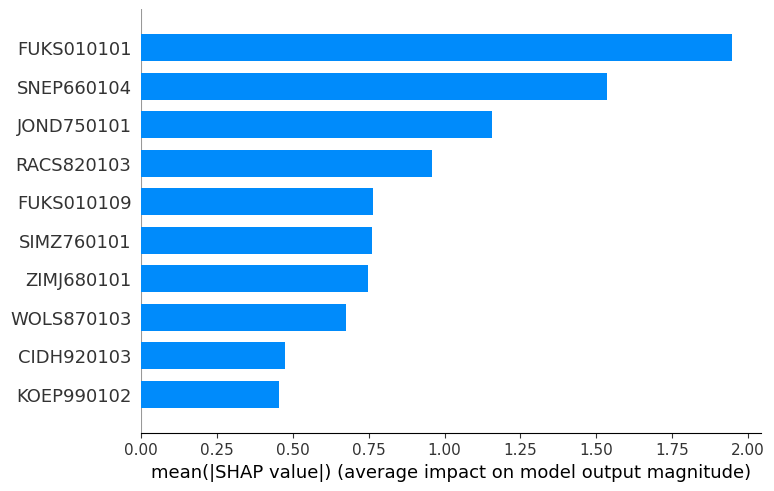

In [61]:
shap.summary_plot(shap_values, X_train, plot_type="bar", max_display = 10)

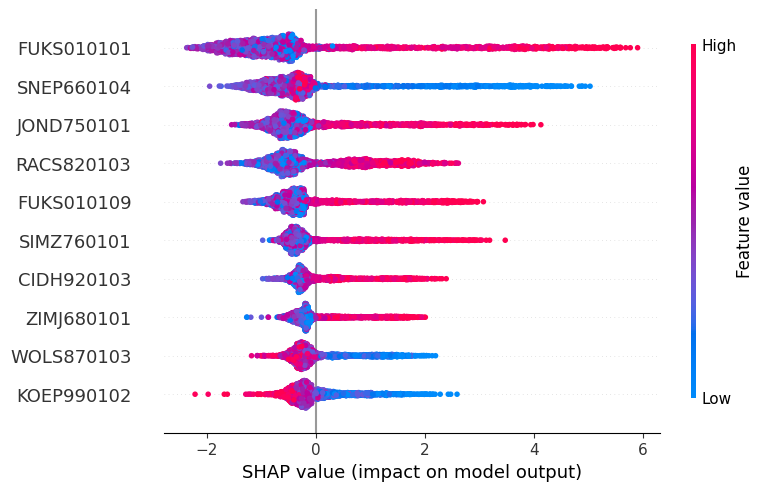

In [64]:
shap.summary_plot(shap_values_xgb, X_train, max_display = 10)

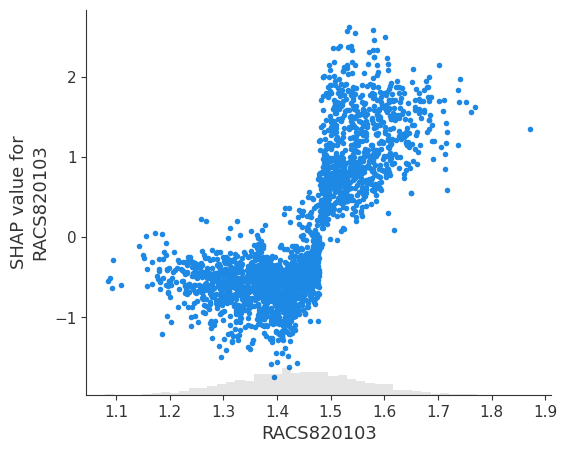

In [84]:
shap.plots.scatter(shap_values_xgb[:,'RACS820103'])

ValueError: Unable to determine Axes to steal space for Colorbar. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.

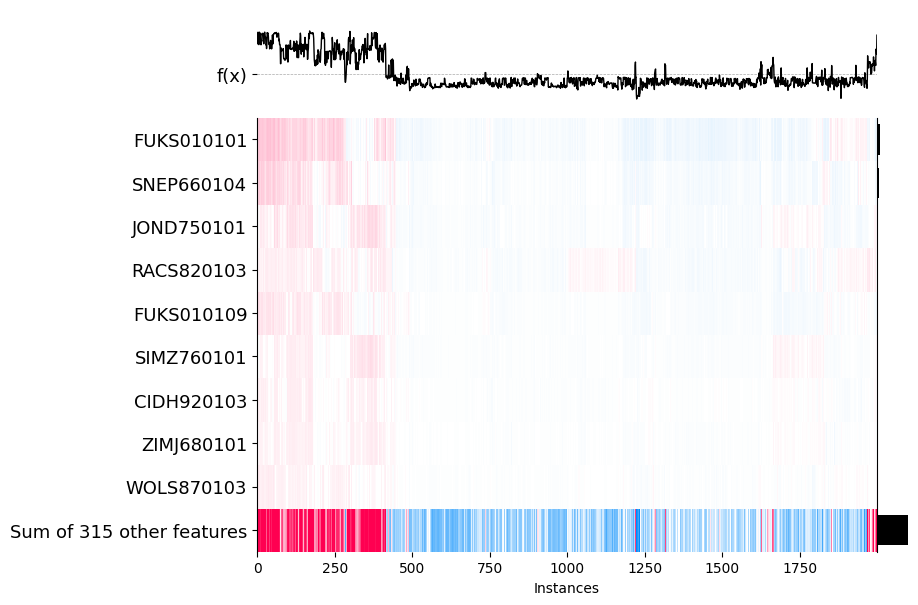

In [88]:
shap.plots.heatmap(shap_values_xgb[:2000])

ValueError: too many values to unpack (expected 1)

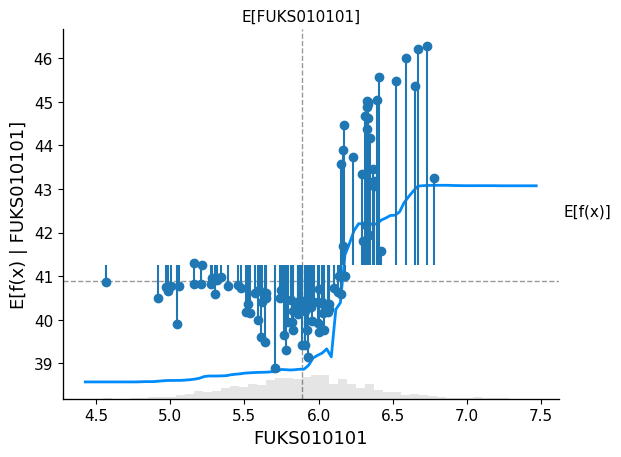

In [70]:
fig,ax = shap.partial_dependence_plot(
    "FUKS010101", model.predict, X100, model_expected_value=True,
    feature_expected_value=True, show=False, ice=False,
    shap_values=shap_values_xgb[0:100+1,:]
)

In [19]:
Data_Full

,A,C,D,E,F,G,H,I,K,L,...,YYM,YYN,YYP,YYQ,YYR,YYS,YYT,YYV,YYW,YYY
0,0.057292,0.005208,0.067708,0.093750,0.015625,0.072917,0.010417,0.078125,0.093750,0.088542,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0
1,0.128743,0.023952,0.065868,0.059880,0.053892,0.068862,0.032934,0.041916,0.017964,0.083832,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0
2,0.046154,0.003846,0.080769,0.046154,0.038462,0.076923,0.011538,0.134615,0.107692,0.084615,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0
3,0.044910,0.000000,0.020958,0.029940,0.047904,0.059880,0.008982,0.092814,0.026946,0.059880,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0
4,0.048000,0.016000,0.044000,0.108000,0.044000,0.076000,0.032000,0.092000,0.056000,0.108000,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2912,0.104418,0.016064,0.048193,0.024096,0.038153,0.130522,0.016064,0.040161,0.028112,0.054217,...,0.0,0.0,0.0,0.000000,0.000000,0.002016,0.0,0.0,0.0,0.0
2913,0.034268,0.009346,0.080997,0.077882,0.052960,0.034268,0.021807,0.087227,0.090343,0.105919,...,0.0,0.0,0.0,0.003135,0.000000,0.000000,0.0,0.0,0.0,0.0
2914,0.107256,0.006309,0.066246,0.059937,0.044164,0.088328,0.025237,0.088328,0.044164,0.072555,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0
2915,0.065630,0.012090,0.077720,0.065630,0.069085,0.051813,0.036269,0.062176,0.065630,0.077720,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0


In [8]:
scaler = StandardScaler()
  # transform data
Data_Full_s = scaler.fit_transform(Data_Full)
Data_Full_s = pd.DataFrame(Data_Full_s)
Data_Full_s

,0,1,2,3,4,5,6,7,8,9,...,8964,8965,8966,8967,8968,8969,8970,8971,8972,8973
0,-1.023056,-0.602029,0.562833,1.205018,-1.768946,-0.338811,-1.218386,0.848281,1.528621,0.070901,...,-0.102033,-0.168099,-0.180309,-0.154221,-0.151130,-0.188306,-0.191266,-0.180899,-0.088864,-0.180439
1,1.338968,1.535178,0.441042,-0.214374,1.044964,-0.533888,0.947390,-0.762430,-1.398985,-0.146976,...,-0.102033,-0.168099,-0.180309,-0.154221,-0.151130,-0.188306,-0.191266,-0.180899,-0.088864,-0.180439
2,-1.391250,-0.757348,1.427309,-0.789611,-0.089703,-0.146043,-1.110489,3.361195,2.067211,-0.110748,...,-0.102033,-0.168099,-0.180309,-0.154221,-0.151130,-0.188306,-0.191266,-0.180899,-0.088864,-0.180439
3,-1.432363,-1.195896,-2.531479,-1.469086,0.604645,-0.966058,-1.356372,1.501722,-1.052010,-1.255114,...,-0.102033,-0.168099,-0.180309,-0.154221,-0.151130,-0.188306,-0.191266,-0.180899,-0.088864,-0.180439
4,-1.330220,0.628462,-1.006377,1.802198,0.317558,-0.190456,0.857543,1.465495,0.070340,0.971136,...,-0.102033,-0.168099,-0.180309,-0.154221,-0.151130,-0.188306,-0.191266,-0.180899,-0.088864,-0.180439
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2912,0.534837,0.635788,-0.728866,-1.713981,-0.112419,2.432872,-0.675189,-0.840522,-1.006954,-1.517129,...,-0.102033,-0.168099,-0.180309,-0.154221,-0.151130,3.234190,-0.191266,-0.180899,-0.088864,-0.180439
2913,-1.784176,-0.130266,1.442377,0.540016,0.976378,-2.198395,-0.122855,1.253192,1.396996,0.874860,...,-0.102033,-0.168099,-0.180309,7.041907,-0.151130,-0.188306,-0.191266,-0.180899,-0.088864,-0.180439
2914,0.628651,-0.476512,0.466048,-0.212000,0.329620,0.402709,0.207025,1.302154,-0.386882,-0.668710,...,-0.102033,-0.168099,-0.180309,-0.154221,-0.151130,-0.188306,-0.191266,-0.180899,-0.088864,-0.180439
2915,-0.747394,0.182613,1.225500,0.026599,2.162110,-1.354190,1.268185,0.138814,0.442362,-0.429752,...,-0.102033,-0.168099,-0.180309,-0.154221,-0.151130,-0.188306,-0.191266,-0.180899,-0.088864,-0.180439


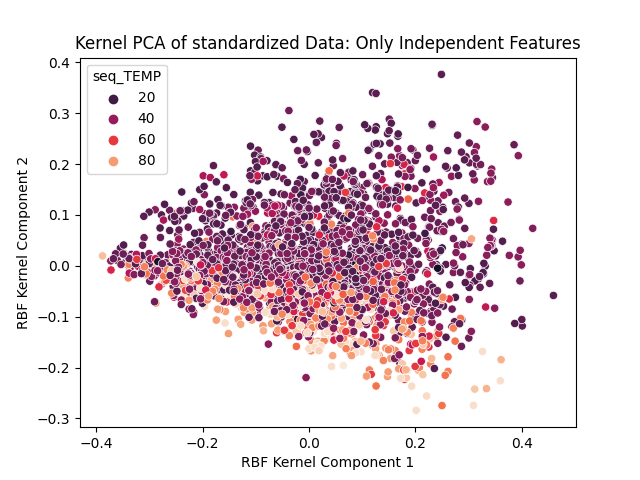

In [21]:
kpca = KernelPCA(n_components=2, kernel='rbf')
x_kpca = kpca.fit_transform(Data_Full_s)

x_tx = x_kpca
x_tx =pd.DataFrame(x_tx)
x_tx["seq_TEMP"] = data["seq_TEMP"]

# Create cool scatter plot
fig = sns.scatterplot(x=x_tx[0], y=x_tx[1],
                hue=x_tx['seq_TEMP'],
                palette='rocket')
plt.xlabel("RBF Kernel Component 1")
plt.ylabel("RBF Kernel Component 2")
plt.title("Kernel PCA of standardized Data: Only Independent Features")
plt.show(fig)

In [10]:
kpca = KernelPCA(n_components=3, kernel='rbf')
x_kpca = kpca.fit_transform(Data_Full_s)

x_tx = x_kpca
x_tx =pd.DataFrame(x_tx)
x_tx["seq_TEMP"] = data["seq_TEMP"]

fig = px.scatter_3d(x_tx, x=0, y=1, z=2,
              color='seq_TEMP')
fig.show()

In [13]:
def k_pca_3d(gamma):
    gamma = 1/gamma
    kpca = KernelPCA(n_components=3, kernel='rbf', gamma= gamma)
    x_kpca = kpca.fit_transform(Data_Full_s)


    x_tx = x_kpca
    x_tx =pd.DataFrame(x_tx)
    x_tx["seq_TEMP"] = data["seq_TEMP"]

    fig = px.scatter_3d(x_tx, x=0, y=1, z=2,
                color='seq_TEMP')
    return fig.show()
    

In [11]:
%matplotlib widget
import ipywidgets as widgets
import matplotlib.pyplot as plt
import numpy as np

In [9]:
kpca = KernelPCA(n_components=100, kernel='rbf')
x_kpca = kpca.fit_transform(Data_Full_s)

x_tx = x_kpca
x_tx =pd.DataFrame(x_tx)
x_tx["Topt"] = data["seq_TEMP"]

In [10]:
x_tx

,0,1,2,3,4,5,6,7,8,9,...,91,92,93,94,95,96,97,98,99,Topt
0,-0.196055,-0.042094,-0.013781,-0.036662,0.034378,-0.042475,-0.011677,-0.009253,0.009728,0.017807,...,-0.008525,0.007022,0.021454,0.000486,-0.003861,-0.005826,0.018682,0.006424,-0.011340,85
1,-0.113611,-0.007128,0.048242,-0.013750,0.016516,0.071876,0.001365,0.012502,-0.009035,-0.004395,...,-0.002315,-0.011485,0.006603,-0.019635,0.028308,0.005431,0.015656,0.007427,-0.024645,26
2,-0.110135,-0.044392,-0.078837,0.018349,-0.050911,-0.063082,-0.004171,-0.008687,-0.012094,0.016396,...,0.001021,0.025210,0.008648,-0.012184,-0.030763,-0.001019,-0.002355,-0.010232,-0.005958,80
3,-0.192614,0.048074,-0.025019,0.072662,-0.108870,0.004133,-0.006470,-0.009897,0.005480,-0.053531,...,0.018778,-0.006176,-0.006344,-0.020756,0.009426,0.057265,0.052221,-0.066253,0.024096,74
4,-0.052681,-0.088100,-0.044475,0.630984,0.352410,-0.046214,0.003842,0.015985,-0.006946,0.008586,...,0.004691,0.011214,-0.018229,-0.004744,0.002392,0.000928,0.024622,0.003750,-0.015730,30
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2912,0.009416,0.258566,0.013194,0.003804,0.002152,-0.077556,-0.028839,-0.006039,-0.043725,-0.003982,...,-0.006314,-0.004889,-0.012752,-0.025669,0.001802,0.009472,-0.042618,0.033646,-0.003801,25
2913,-0.140738,-0.050371,-0.109608,-0.020748,0.009276,0.015222,0.009332,-0.007429,0.008265,0.002828,...,0.006770,0.009170,0.002928,-0.012447,-0.005332,0.000797,-0.024875,-0.001042,-0.013979,28
2914,-0.035113,-0.050040,0.040427,0.021582,-0.063057,-0.041737,-0.007022,-0.001575,-0.014669,0.002975,...,-0.000375,-0.006946,0.016509,-0.001593,-0.001525,0.016717,-0.024259,0.005302,0.008479,54
2915,0.034814,-0.058377,-0.111998,0.037129,-0.068538,0.097967,0.022074,-0.009856,-0.024439,-0.012831,...,-0.022985,-0.015186,0.055117,-0.040162,-0.009226,-0.015127,-0.038988,-0.059680,-0.041175,54


In [11]:
input_d = x_tx

In [12]:
model2 = xgb.XGBRegressor(
                         num_parallel_tree = 100,
                         max_depth = 15,
                         n_estimators=2000,
                         learning_rate = 0.05,
                         verbosity = 2,
                         booster = 'gbtree',
                         n_jobs = -1,
                         sampling_method ='uniform',
                         subsample = 0.75,
                         colsample_bytree = 0.3,
                         objective ='reg:squarederror',
                         gamma = 10,
                         reg_alpha = 5,
                         reg_lambda =5,
                         eval_metric = ["rmse"]
                        )

In [13]:
from verstack.stratified_continuous_split import scsplit
from sklearn.metrics import mean_squared_error
rmse = []
r_2  = []
for i in range(0,1):
    train, test = scsplit(input_d, stratify = input_d["Topt"],test_size = 0.2,train_size = 0.8, random_state = 5)
    train['Topt'] = train['Topt'].apply(np.ceil)
    train["Topt"] = train["Topt"].astype('int')
    X_train = train.drop(columns=["Topt"], axis = 1)
    X_test  = test.drop(columns=["Topt"], axis = 1)
    y_train = train["Topt"]
    y_test  = test["Topt"]

    model2.fit(X_train,y_train,eval_set=[(X_test, y_test)],early_stopping_rounds=10)
    r_2_scr = r2_score(y_test,model2.predict(X_test))
    rmse_scr = mean_squared_error(y_test,model2.predict(X_test), squared=False)
    
    r_2.append(r_2_scr)
    rmse.append(rmse_scr)

[13:13:29] INFO: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/tree/updater_prune.cc:98: tree pruning end, 82 extra nodes, 0 pruned nodes, max_depth=15
[13:13:29] INFO: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/tree/updater_prune.cc:98: tree pruning end, 26 extra nodes, 0 pruned nodes, max_depth=12
[13:13:29] INFO: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/tree/updater_prune.cc:98: tree pruning end, 36 extra nodes, 0 pruned nodes, max_depth=9
[13:13:29] INFO: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/tree/updater_prune.cc:98: tree pruning end, 32 extra nodes, 0 pruned nodes, max_depth=13
[13:13:29] INFO: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4

In [14]:
import pickle
pickle.dump(model2, open("model/model_KPCA-100_dimension_reduction.pkl", "wb"))

In [44]:
rmse_df = pd.DataFrame(rmse,columns = ["RMSE"])
rmse_df["R_2"] = r_2
rmse_df.to_csv("data/results_r2_rmse_3d_kpca.csv")

In [37]:
r_2

[0.7177456272297664]

In [38]:
rmse

[10.549515565023727]

In [15]:
X100 = shap.utils.sample(X_train, 500)
explainer_xgb = shap.Explainer(model2, X100)
shap_values_xgb = explainer_xgb(X_train)

100%|===================| 2332/2333 [188:00<00:04]        

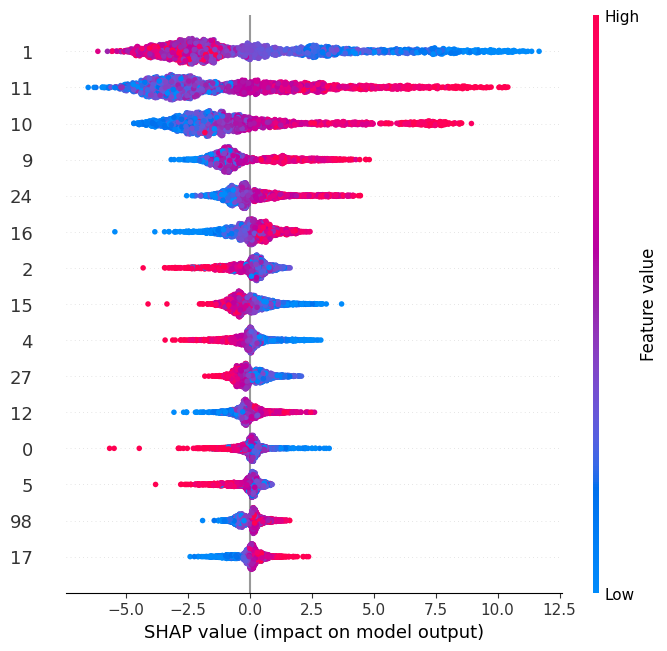

In [18]:
shap.summary_plot(shap_values_xgb, X_train, max_display = 15)

ValueError: Unable to determine Axes to steal space for Colorbar. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.

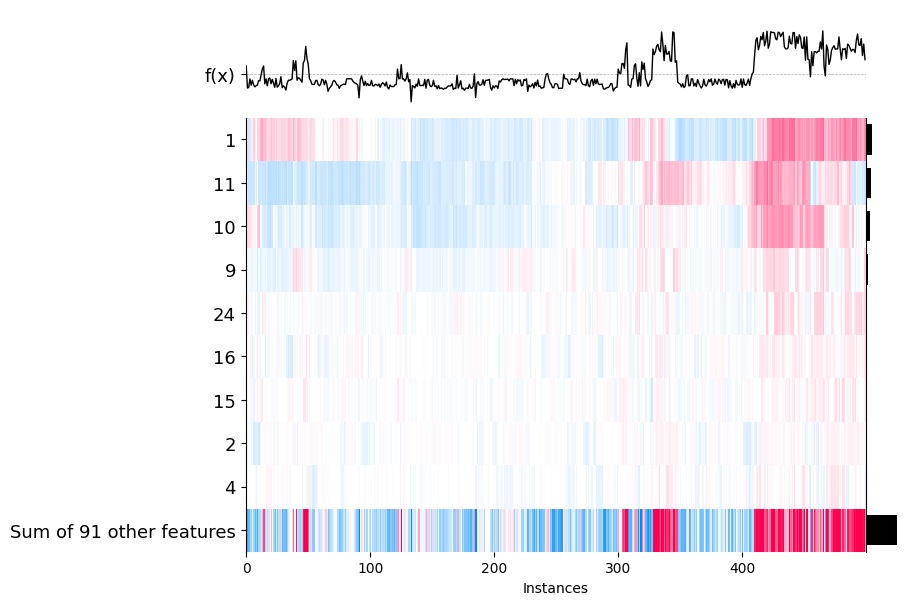

In [20]:
shap.plots.heatmap(shap_values_xgb[:500])